In [1]:
# import library
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

In [2]:
# load dataset
data = pd.read_csv("diamonds.csv")
data.head()

,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z
0,1,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,2,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,3,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,4,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,5,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


In [3]:
# Delet the column
data = data.drop("Unnamed: 0",axis=1)

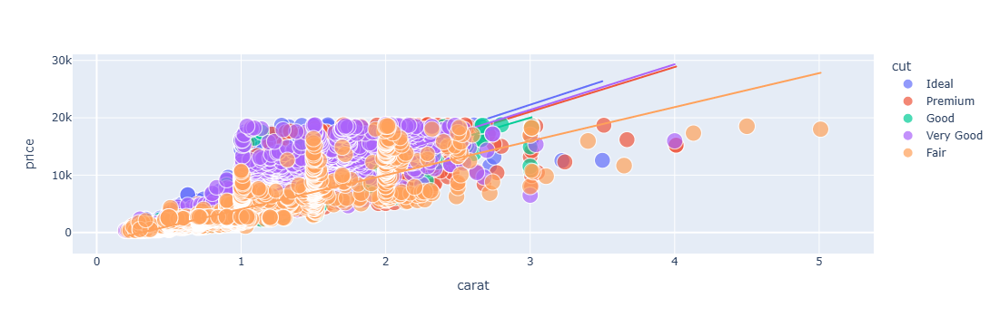

In [4]:
# Relationship between the carat and price of diamond
figure = px.scatter(data_frame = data, x="carat", y="price", size="depth", color="cut", trendline="ols")
figure.show()

In [5]:
# add new column
data["size"] = data["x"] * data["z"]
data

,carat,cut,color,clarity,depth,table,price,x,y,z,size
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43,9.5985
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31,8.9859
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31,9.3555
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63,11.0460
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75,11.9350
...,...,...,...,...,...,...,...,...,...,...,...
53935,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50,20.1250
53936,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61,20.5409
53937,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56,20.1496
53938,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74,23.0010


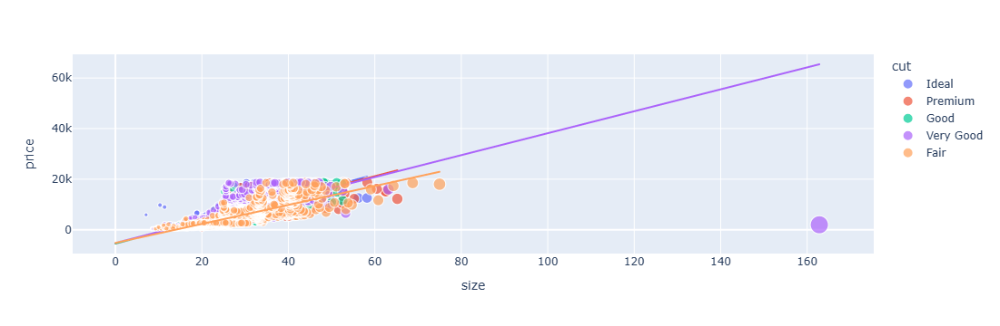

In [6]:
# relationship between the size and the price of diamond
figure = px.scatter(data_frame = data, x="size", y="price", size="size", color="cut", trendline="ols")
figure.show()

In [7]:
# the price of all types of diamond based on their colour
fig = px.box(data, x="cut", y="price", color="color")
fig.show()

In [8]:
fig = px.box(data, x="cut", y="price", color="clarity")
fig.show()

In [9]:
# Correlation between diamond price and other features in the dataset
data = data.apply(pd.to_numeric, errors='coerce')
correlation = data.corr()
print(correlation["price"].sort_values(ascending=False))

price      1.000000
carat      0.921591
size       0.903501
x          0.884435
y          0.865421
z          0.861249
table      0.127134
depth     -0.010647
cut             NaN
color           NaN
clarity         NaN
Name: price, dtype: float64


In [10]:
# convert the values of the cut column into a numerical feature
data["cut"] = data["cut"].map({"Ideal": 1, "Premium": 2, "Good": 3, "Very Good": 4, "fair": 5})

In [11]:
# spliting and train the data set
from sklearn.model_selection import train_test_split

In [12]:
x = np.array(data[["carat", "cut", "size"]])
y = np.array(data[["price"]])

xtrain, xtest, ytrain, ytest = train_test_split(x, y, test_size=0.10, random_state=42)

In [13]:
# train the machine learning model
from sklearn.ensemble import RandomForestRegressor

In [14]:
model = RandomForestRegressor()
model.fit(xtrain, ytrain) 

E:\anaconda\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



RandomForestRegressor()

In [15]:
# machine learning model to Predict the price of Diamond  
print("Diamond Price Prediction")
a = float(input("Carat Size: "))
b = int(input("Cut Type (Ideal: 1, Premium: 2, Good: 3, Very Good: 4, Fair: 5): "))
c = float(input("size: "))
features = np.array([[a, b, c]])
print("Predicted Diamond's Price = ", model.predict(features))

Diamond Price Prediction


Carat Size:  0.70
Cut Type (Ideal: 1, Premium: 2, Good: 3, Very Good: 4, Fair: 5):  2
size:  40


Predicted Diamond's Price =  [2404.24]
